# Deze notebook kan paden vinden

Je hebt een volledige graaf nodig

In [1]:
from model_find_paths import connect_distribution_to_postnl
from model_plot_graph import plot_graph_on_folium, plot_uav_segments_with_legend, plot_uav_corridors
from model_get_data import read_geojson
from model_evaluation import evaluate_alpha_tradeoff, plot_common_etypes_per_alpha, plot_pareto_tradeoff

import numpy as np

In [5]:
city = 'alphen-waddinxveen' # use lower case
depot = ['Alphen aan den Rijn (NLI)', 'Waddinxveen']

In [6]:
import pickle
import networkx as nx

with open(f'/Users/cmartens/Documents/thesis_cf_martens/model/graph_creation/output/{city}.pkl', 'rb') as f:
    G = pickle.load(f)

In [9]:
gdf, lines_gdf, polygons_gdf, post_nl_gdf, no_fly_zones_gdf = read_geojson(f'/Users/cmartens/Documents/thesis_cf_martens/3.no_fly_zones/output/data_for_graph_{city}.geojson', depot, all=True)

Getting separate dataframes for lines, polygons, postnl points, distribution points and no fly zones
Looking for distribution points in ['Alphen aan den Rijn (NLI)', 'Waddinxveen']
Found 2 distribution points in ['Alphen aan den Rijn (NLI)', 'Waddinxveen']
Found 22830 lines, 9108 polygons, 83 postnl points, 2 distribution point and 7 no-fly zones


In [10]:
no_fly_zones_gdf

,name,id,description,area_type,category,risk,Height,air_type,geometry
32346,Industriegebied met risicos op zware ongevallen,NaN,OPEN cat. vluchten zijn hier verboden SPEC cat...,No-fly zone,Industry,no_fly_zone,NaN,High-Risk Areas,"POLYGON ((104560.374 461789.357, 104560.336 46..."
32347,Gebied met verbod vanuit beveiligingsoverwegingen,NaN,OPEN cat. vluchten zijn hier verboden SPEC cat...,No-fly zone,Security,no_fly_zone,NaN,Restricted Zones,"POLYGON ((103921.671 460714.176, 103921.633 46..."
32348,Gebied met verbod vanuit beveiligingsoverwegingen,NaN,OPEN cat. vluchten zijn hier verboden SPEC cat...,No-fly zone,Security,no_fly_zone,NaN,Restricted Zones,"POLYGON ((103752.757 460932.286, 103752.719 46..."
32349,geografische zone van een beveiligd gebied of ...,NaN,OPEN cat. vluchten zijn hier verboden SPEC cat...,No-fly zone,Security,no_fly_zone,NaN,Restricted Zones,"POLYGON ((104950.064 461596.382, 104950.052 46..."
32350,geografische zone van een beveiligd gebied of ...,NaN,OPEN cat. vluchten zijn hier verboden SPEC cat...,No-fly zone,Security,no_fly_zone,NaN,Restricted Zones,"POLYGON ((100237.286 460193.56, 100237.274 460..."
32351,Natura 2000 Area De Wilck,NaN,Natura 2000-besluit 7 mei 2013,No-fly zone,Environment,no_fly_zone,NaN,Protected Nature Reserves,"MULTIPOLYGON (((97168.115 459219.521, 97153.53..."
32352,Natura 2000 Area Nieuwkoopse Plassen & De Haeck,NaN,Natura 2000-besluit 06 januari 2014,No-fly zone,Environment,no_fly_zone,NaN,Protected Nature Reserves,"MULTIPOLYGON (((116918.154 464732.231, 116914...."


In [11]:
def plot_polygons_static(gdf_polygons, city_name="Unknown",
                         no_fly_zones_gdf=None, postnl_points=None, title=None, focus_radius_km=17):
    """
    Plot area-type polygons with consistent color coding on a static background map,
    including optional overlays for no-fly zones and PostNL/distribution points.

    Args:
        gdf_polygons (GeoDataFrame): Polygons with an 'area_type' column and EPSG:28992 CRS.
        city_name (str): Name of the city to use in the plot title.
        no_fly_zones_gdf (GeoDataFrame): Optional. Polygons representing no-fly zones.
        postnl_points (GeoDataFrame): Optional. Points with 'ntype' column: 'postnl' or 'distribution'.

    Returns:
        matplotlib.figure.Figure: The generated matplotlib figure.
    """

    import matplotlib.pyplot as plt
    from matplotlib.patches import Patch
    from matplotlib.lines import Line2D
    import contextily as ctx

    area_color_map = {
        # Infrastructuur
        'Motorways and major roads': '#E31A1C',       # felrood
        'Regional roads': '#F46D43',                  # vurig oranje
        'Tracks and rural access roads': '#D95F02',   # donkeroranje
        'Living and residential streets': '#FFCB05',  # felgeel
        'Pedestrian and cycling paths': '#66C2A5',    # turquoisegroen
        'Railways': '#4B4B4B',                        # donkergrijs
        'Helipads': '#F0027F',
        'Airports and airfields': '#A6CEE3',

        # Energie & communicatie
        'Power lines': '#999999',
        'Power plants': '#FF8C00',
        'Communication towers': '#FB9A99',
        'High infrastructures': '#888888',

        # Gebouwd gebied
        'Industrial zones': '#377EB8',               # helderblauw
        'Commercial zones': '#FFC300',               # goudgeel
        'Retail zones': '#FF8C00',                   # warm oranje
        'Residential areas': '#FFA07A',              # warm zalm/oranjerood – beter onderscheid met 'Retail zones'
        'Schools and universities': '#DAA520',
        'Hospitals': '#DC143C',
        'Care homes': '#FF9999',
        'Prisons': '#696969',
        'Religious sites': '#C71585',
        'Cemeteries': '#556B2F',
        'Cultural sites': '#8A2BE2',

        # Natuur
        'Parks': '#7CFC00',                          # limegroen
        'Recreational zones': '#20B2AA',
        'Meadows and open grass': '#9ACD32',         # geelgroen
        'Forests and woodlands': '#228B22',          # bosgroen
        'Agricultural lands': '#BFD92E',             # helderder dan '#ADDE87'
        'Wetlands': '#66B2FF',                       # licht, helder blauw
        'Lakes and ponds': '#1E90FF',                # diepblauw (meer contrast met 'Wetlands')
        'Water reservoirs': '#4682B4',
        'Rivers, canals and streams': '#5DADE2',
        'Natura2000 areas': '#005824',

        # Overig
        'connector': '#D3D3D3',
        'No-fly zone': '#B22222'
    }
    if gdf_polygons.empty:
        raise ValueError("GeoDataFrame is empty – no polygons to plot.")

    # Project to Web Mercator
    gdf_web = gdf_polygons.to_crs(epsg=3857)

    # Bereken middelpunt van alle polygonen
    centroid = gdf_web.unary_union.centroid
    x0, y0 = centroid.x, centroid.y

    # Zet radius om naar meters
    buffer_m = focus_radius_km * 1000

    # Stel bounds in: min/max x/y
    xlim = (x0 - buffer_m, x0 + buffer_m)
    ylim = (y0 - buffer_m, y0 + buffer_m)

    gdf_web["color"] = gdf_web["area_type"].map(area_color_map).fillna("#cccccc")

    if no_fly_zones_gdf is not None and not no_fly_zones_gdf.empty:
        # Filter expliciet op 'No-fly zone'
        no_fly_zones_filtered = no_fly_zones_gdf[no_fly_zones_gdf['area_type'] == 'No-fly zone']
        no_fly_zones_web = no_fly_zones_filtered.to_crs(epsg=3857)

    if postnl_points is not None:
        postnl_points_web = postnl_points.to_crs(epsg=3857)

    # Plot setup
    fig, ax = plt.subplots(figsize=(14, 12))
    gdf_web.plot(ax=ax, facecolor=gdf_web["color"], edgecolor='black', alpha=0.3, linewidth=0.5)

    if no_fly_zones_gdf is not None:
        no_fly_zones_web.plot(ax=ax, facecolor="#B22222", edgecolor='black', alpha=0.4, linewidth=0.7)

    # Plot PostNL & distribution points with scatter for better control
    if postnl_points is not None:
        if 'area_type' in postnl_points.columns:
            for area_type, group in postnl_points_web.groupby("area_type"):
                if area_type == "distribution":
                    ax.scatter(
                        group.geometry.x, group.geometry.y,
                        marker='o', s=150, c='green', edgecolors='black',
                        label='Distribution point', zorder=6
                    )
                elif area_type == "postnl point":
                    ax.scatter(
                        group.geometry.x, group.geometry.y,
                        marker='o', s=100, c='blue', edgecolors='black',
                        label='PostNL point', zorder=6
                    )
                else:
                    ax.scatter(
                        group.geometry.x, group.geometry.y,
                        marker='x', s=80, c='grey', edgecolors='black',
                        label=f'Other: {area_type}', zorder=6
                    )
        else:
            ax.scatter(
                postnl_points_web.geometry.x, postnl_points_web.geometry.y,
                marker='o', s=100, c='blue', edgecolors='black',
                label='PostNL points', zorder=6
            )

    # Basemap
    # ax.set_xlim(xlim)
    # ax.set_ylim(ylim)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, alpha=0.6, zoom=12)

    # Title and formatting
    ax.set_title(f"{title}", fontsize=16)
    ax.set_axis_off()

    # Legend
    used_types = gdf_web["area_type"].unique()
    legend_patches = [
        Patch(facecolor=color, edgecolor='black', label=atype)
        for atype, color in area_color_map.items()
        if atype in used_types
    ]

    if postnl_points is not None:
        legend_patches.append(Line2D([0], [0], marker='o', color='w', markerfacecolor='green',
                                     markeredgecolor='black', markersize=10, label='Distribution point'))
        legend_patches.append(Line2D([0], [0], marker='o', color='w', markerfacecolor='blue',
                                     markeredgecolor='black', markersize=10, label='PostNL point'))

    if no_fly_zones_gdf is not None and not no_fly_zones_gdf.empty:
        legend_patches.append(Patch(facecolor='#B22222', edgecolor='black', label='No-fly zone'))

    ax.legend(
        handles=legend_patches,
        title="Area Type",
        loc="upper left",
        bbox_to_anchor=(1.15, 1)
    )

    plt.tight_layout()
    return fig


/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/1795688204.py:75: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  centroid = gdf_web.unary_union.centroid


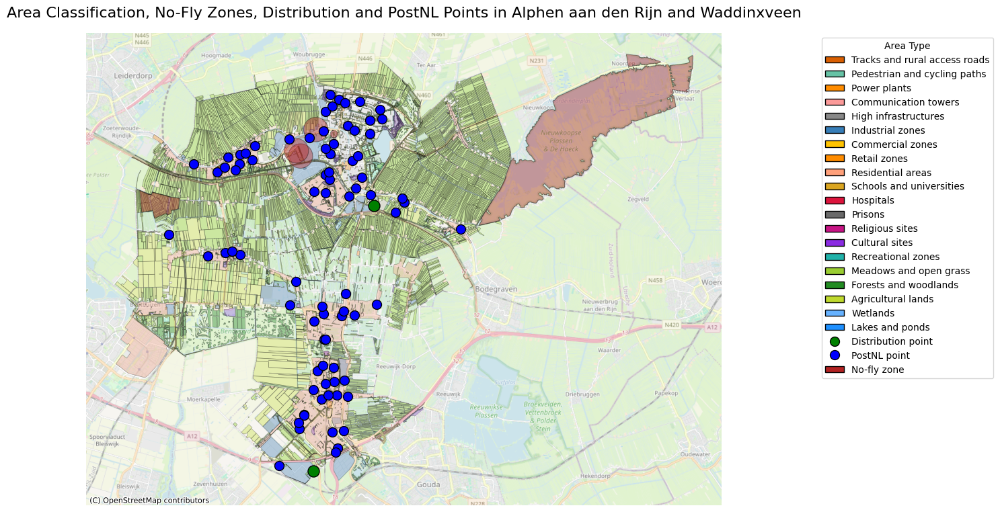

In [12]:
fig = plot_polygons_static(polygons_gdf, city_name=city, postnl_points=post_nl_gdf, title='Area Classification, No-Fly Zones, Distribution and PostNL Points in Alphen aan den Rijn and Waddinxveen', no_fly_zones_gdf=no_fly_zones_gdf)
fig.savefig(f"output/map_{city}.pdf", dpi=300, bbox_inches="tight")

In [9]:
# plot_graph_on_folium(G, plot_waypoints=False, plot_all_lines=True, gdf_polygons=polygons_gdf)

In [13]:
connected_1, not_connected = connect_distribution_to_postnl(G, 1, method='dijkstra')

Distribution points: 2
PostNL points: 81
Alpha: 1, Method: dijkstra
Connected: 156678 → 0 | 5764.1 m | 222 nodes
Connected: 156678 → 1 | 3895.1 m | 171 nodes
Connected: 156678 → 2 | 5209.9 m | 128 nodes
Connected: 156678 → 3 | 2734.2 m | 121 nodes
Connected: 156678 → 4 | 22827.9 m | 374 nodes
Connected: 156678 → 5 | 2317.7 m | 100 nodes
Connected: 156678 → 6 | 19846.7 m | 302 nodes
Connected: 156678 → 7 | 22853.5 m | 376 nodes
Connected: 156678 → 8 | 3839.2 m | 170 nodes
Connected: 156678 → 9 | 2683.1 m | 107 nodes
Connected: 156678 → 10 | 6233.0 m | 168 nodes
Connected: 156678 → 11 | 3126.8 m | 127 nodes
Connected: 156678 → 12 | 7225.0 m | 303 nodes
Connected: 156678 → 13 | 7038.6 m | 198 nodes
No path: 14
Connected: 156678 → 15 | 2335.3 m | 104 nodes
Connected: 156678 → 16 | 8628.7 m | 182 nodes
Connected: 156678 → 17 | 12138.1 m | 247 nodes
Connected: 156678 → 18 | 9398.8 m | 172 nodes
Connected: 156678 → 19 | 17941.4 m | 234 nodes
Connected: 156678 → 20 | 6545.5 m | 268 nodes
Conne

In [17]:
import folium
import pyproj
from shapely.geometry import Point, LineString, Polygon
from shapely.ops import transform
from shapely.wkt import loads as wkt_loads
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from matplotlib.lines import Line2D

def plot_uav_segments_with_legend(connected_paths, city_name, title, postnl_points=None):
    import matplotlib.pyplot as plt
    import contextily as ctx
    from matplotlib.lines import Line2D
    """
    Plot a map of UAV corridor segments colored by edge type (etype), with a fixed, clear legend.

    Args:
        connected_paths (list): List of tuples containing route data, including path geometries and etype arrays.
        area_color_map (dict): Mapping of etype labels to HEX color codes.
        city_name (str): Name of the city to include in the plot title.

    Returns:
        matplotlib.figure.Figure: The generated plot figure object (for saving or displaying).
    """

    area_color_map = {
        # Infrastructuur
        'Motorways and major roads': '#E31A1C',       # felrood
        'Regional roads': '#F46D43',                  # vurig oranje
        'Tracks and rural access roads': '#D95F02',   # donkeroranje
        'Living and residential streets': '#FFCB05',  # felgeel
        'Pedestrian and cycling paths': '#66C2A5',    # turquoisegroen
        'Railways': '#4B4B4B',                        # donkergrijs
        'Helipads': '#F0027F',
        'Airports and airfields': '#A6CEE3',

        # Energie & communicatie
        'Power lines': '#999999',
        'Power plants': '#FF8C00',
        'Communication towers': '#FB9A99',
        'High infrastructures': '#888888',

        # Gebouwd gebied
        'Industrial zones': '#377EB8',               # helderblauw
        'Commercial zones': '#FFC300',               # goudgeel
        'Retail zones': '#FF8C00',                   # warm oranje
        'Residential areas': '#FFA07A',              # warm zalm/oranjerood – beter onderscheid met 'Retail zones'
        'Schools and universities': '#DAA520',
        'Hospitals': '#DC143C',
        'Care homes': '#FF9999',
        'Prisons': '#696969',
        'Religious sites': '#C71585',
        'Cemeteries': '#556B2F',
        'Cultural sites': '#8A2BE2',

        # Natuur
        'Parks': '#7CFC00',                          # limegroen
        'Recreational zones': '#20B2AA',
        'Meadows and open grass': '#9ACD32',         # geelgroen
        'Forests and woodlands': '#228B22',          # bosgroen
        'Agricultural lands': '#BFD92E',             # helderder dan '#ADDE87'
        'Wetlands': '#66B2FF',                       # licht, helder blauw
        'Lakes and ponds': '#1E90FF',                # diepblauw (meer contrast met 'Wetlands')
        'Water reservoirs': '#4682B4',
        'Rivers, canals and streams': '#5DADE2',
        'Natura2000 areas': '#005824',

        # Overig
        'connector': '#D3D3D3',
        'No-fly zone': '#B22222'
    }


    # Extract all valid LineStrings and their corresponding etypes
    segments = []
    etypes = []

    for _, _, _, _, path_geometries, etype_array in connected_paths:
        for (line_tuple, *_), etype in zip(path_geometries, etype_array):
            if isinstance(line_tuple, LineString):
                segments.append(line_tuple)
                etypes.append(etype)

    # Create GeoDataFrame from segments
    gdf_segments = gpd.GeoDataFrame({"etype": etypes}, geometry=segments, crs="EPSG:28992")
    print("Loaded segments:", len(gdf_segments))

    # Convert to Web Mercator
    gdf_web = gdf_segments.to_crs(epsg=3857)

    # Prepare plot
    fig, ax = plt.subplots(figsize=(20, 23), dpi=300)
    colors = gdf_web["etype"].map(area_color_map).fillna("#cccccc")
    gdf_web.plot(color=colors, ax=ax, linewidth=6, zorder=2)

    # Plot PostNL and distribution points
    if postnl_points is not None and not postnl_points.empty:
        if postnl_points.crs != "EPSG:28992":
            raise ValueError("postnl_points must use EPSG:28992 CRS")
        postnl_web = postnl_points.to_crs(epsg=3857)

        for area_type, group in postnl_web.groupby("area_type"):
            color = "blue" if area_type == "postnl point" else "green"
            label = "PostNL point" if area_type == "postnl point" else "Distribution point"
            ax.scatter(
                group.geometry.x,
                group.geometry.y,
                c=color,
                edgecolors="black",
                marker="o",
                s=100 if area_type == "postnl point" else 150,
                label=label,
                zorder=3
            )

    # Add basemap
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, alpha=0.5, zorder=1)
    ax.set_axis_off()

    # Title
    if title == 1:
        ax.set_title(f"UAV corridor segments in {city_name} focussed on avoiding high-risk areas (alpha = 1)", fontsize=24)
    elif title == 0:
        ax.set_title(f"UAV corridor segments in {city_name} focussed on efficiency (alpha = 0)", fontsize=24)

    # Create legend
    legend_elements = [
        Line2D([0], [0], color=color, lw=5, label=etype)
        for etype, color in area_color_map.items()
        if etype in gdf_web["etype"].unique()
    ]

    if postnl_points is not None and not postnl_points.empty:
        legend_elements.append(Line2D([0], [0], marker='o', color='w', label='PostNL point',
                                      markerfacecolor='blue', markeredgecolor='black', markersize=10))
        legend_elements.append(Line2D([0], [0], marker='o', color='w', label='Distribution point',
                                      markerfacecolor='green', markeredgecolor='black', markersize=12))

    ax.legend(
        handles=legend_elements,
        title="Corridor Segment Types",
        loc="upper left",
        bbox_to_anchor=(1.15, 1),
        title_fontsize=20,
        fontsize=18
    )

    plt.tight_layout()
    return fig

Loaded segments: 20816


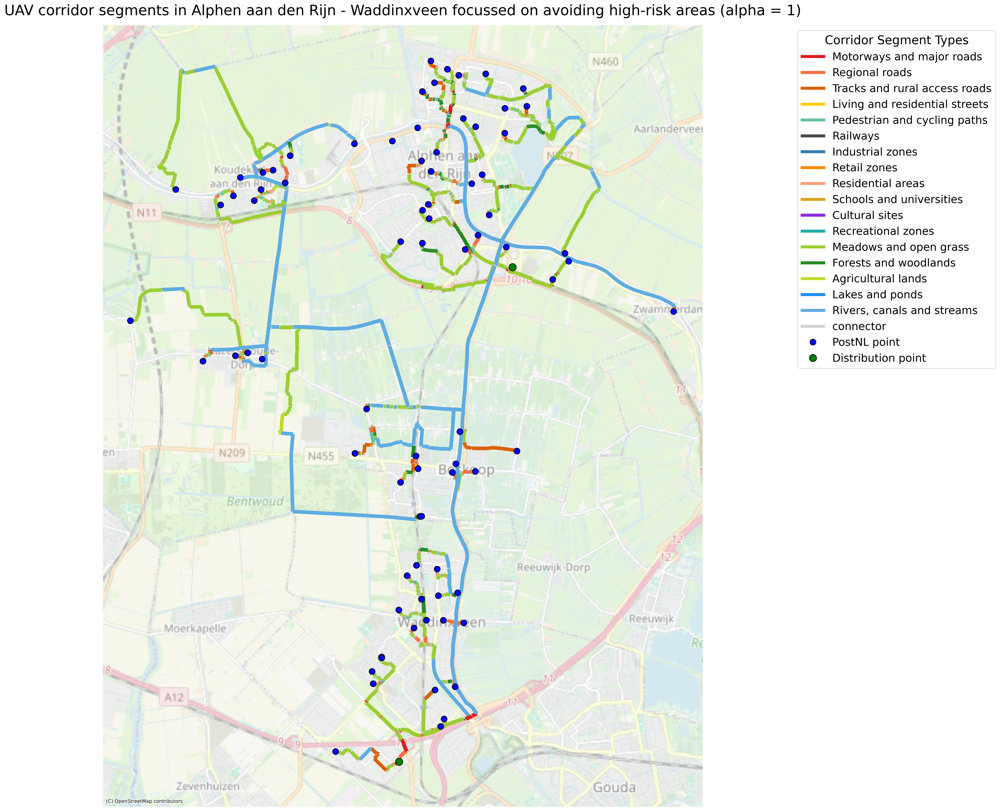

In [18]:
fig = plot_uav_segments_with_legend(connected_1, city_name='Alphen aan den Rijn - Waddinxveen', title=1, postnl_points=post_nl_gdf)
fig.savefig(f"output/{city}_uav_segments_alpha_1.pdf", dpi=300, bbox_inches="tight")

In [20]:
connected_0, not_connected = connect_distribution_to_postnl(G, 0, method='dijkstra')

Distribution points: 2
PostNL points: 81
Alpha: 0, Method: dijkstra
Connected: 156678 → 0 | 3607.5 m | 165 nodes
Connected: 156678 → 1 | 3036.6 m | 124 nodes
Connected: 156678 → 2 | 4236.2 m | 235 nodes
Connected: 156678 → 3 | 2275.2 m | 96 nodes
Connected: 156678 → 4 | 6016.6 m | 213 nodes
Connected: 156678 → 5 | 1664.1 m | 67 nodes
Connected: 156678 → 6 | 15838.6 m | 661 nodes
Connected: 156678 → 7 | 6042.1 m | 215 nodes
Connected: 156678 → 8 | 3014.9 m | 120 nodes
Connected: 156678 → 9 | 2357.4 m | 79 nodes
Connected: 156678 → 10 | 4379.4 m | 193 nodes
Connected: 156678 → 11 | 2644.6 m | 94 nodes
Connected: 156678 → 12 | 4885.3 m | 235 nodes
Connected: 156678 → 13 | 4935.5 m | 219 nodes
No path: 14
Connected: 156678 → 15 | 1783.3 m | 77 nodes
Connected: 156678 → 16 | 7410.4 m | 367 nodes
Connected: 156678 → 17 | 8716.8 m | 402 nodes
Connected: 156678 → 18 | 8359.6 m | 407 nodes
Connected: 156678 → 19 | 15090.3 m | 590 nodes
Connected: 156678 → 20 | 4152.7 m | 214 nodes
Connected: 15

Loaded segments: 30585


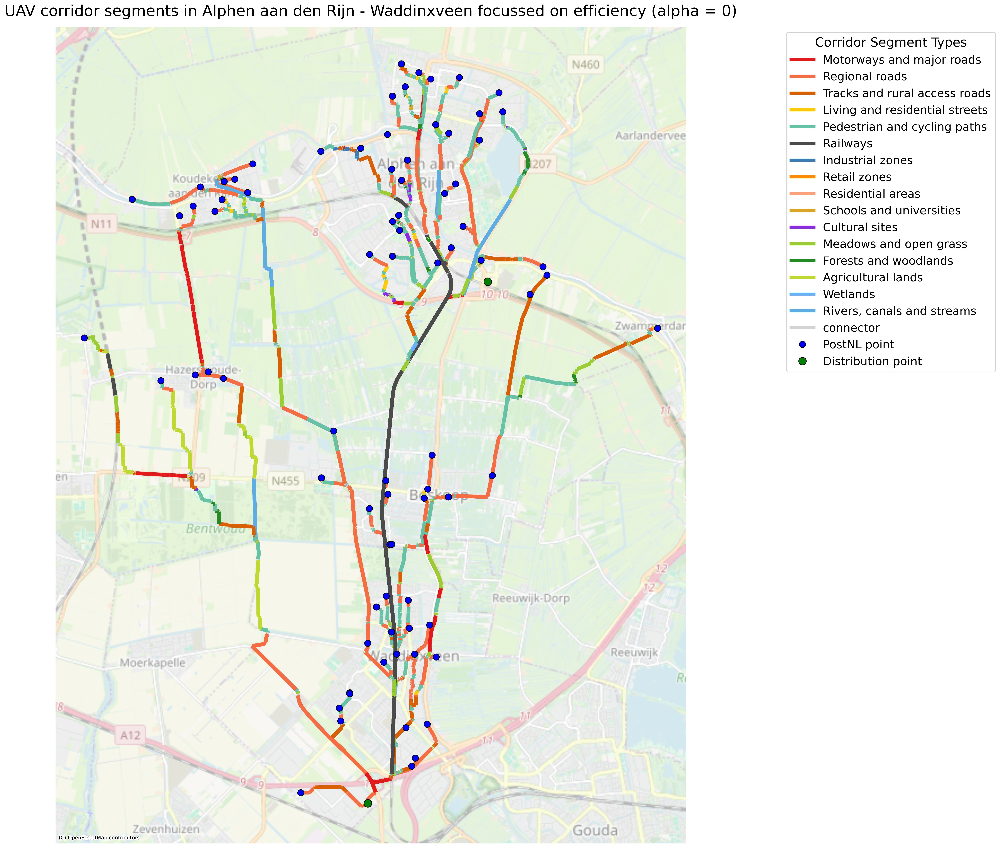

In [21]:
fig = plot_uav_segments_with_legend(connected_0, city_name='Alphen aan den Rijn - Waddinxveen', title=0, postnl_points=post_nl_gdf)
fig.savefig(f"output/{city}_uav_segments_alpha_0.pdf", dpi=300, bbox_inches="tight")

In [22]:
df_summary, all_etypes, etype_dict_per_alpha = evaluate_alpha_tradeoff(G,np.linspace(0, 1, 11), method='dijkstra')

Distribution points: 2
PostNL points: 81
Alpha: 0.0, Method: dijkstra
Connected: 156678 → 0 | 3607.5 m | 165 nodes
Connected: 156678 → 1 | 3036.6 m | 124 nodes
Connected: 156678 → 2 | 4236.2 m | 235 nodes
Connected: 156678 → 3 | 2275.2 m | 96 nodes
Connected: 156678 → 4 | 6016.6 m | 213 nodes
Connected: 156678 → 5 | 1664.1 m | 67 nodes
Connected: 156678 → 6 | 15838.6 m | 661 nodes
Connected: 156678 → 7 | 6042.1 m | 215 nodes
Connected: 156678 → 8 | 3014.9 m | 120 nodes
Connected: 156678 → 9 | 2357.4 m | 79 nodes
Connected: 156678 → 10 | 4379.4 m | 193 nodes
Connected: 156678 → 11 | 2644.6 m | 94 nodes
Connected: 156678 → 12 | 4885.3 m | 235 nodes
Connected: 156678 → 13 | 4935.5 m | 219 nodes
No path: 14
Connected: 156678 → 15 | 1783.3 m | 77 nodes
Connected: 156678 → 16 | 7410.4 m | 367 nodes
Connected: 156678 → 17 | 8716.8 m | 402 nodes
Connected: 156678 → 18 | 8359.6 m | 407 nodes
Connected: 156678 → 19 | 15090.3 m | 590 nodes
Connected: 156678 → 20 | 4152.7 m | 214 nodes
Connected: 

In [23]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D
import numpy as np

def plot_pareto_tradeoff1(df_summary, x_metric="mean_risk", y_metric="mean_energy"):
    """
    Plot Pareto frontier for trade-off between risk and energy with per-alpha color-coded legend.

    Args:
        df_summary (pd.DataFrame): DataFrame from evaluate_alpha_tradeoff.
        x_metric (str): Column name for x-axis (e.g., "mean_risk").
        y_metric (str): Column name for y-axis (e.g., "mean_energy").
    """
    fig = plt.figure(figsize=(8, 6))

    # Create color mapping
    cmap = cm.get_cmap("viridis")
    norm = mcolors.Normalize(vmin=min(df_summary["alpha"]), vmax=max(df_summary["alpha"]))
    alpha_colors = {alpha: cmap(norm(alpha)) for alpha in df_summary["alpha"]}

    # Plot each point individually with its alpha color
    for _, row in df_summary.iterrows():
        plt.scatter(
            row[x_metric],
            row[y_metric],
            color=alpha_colors[row["alpha"]],
            s=100
        )
        plt.text(
            row[x_metric] + 0.01,
            row[y_metric],
            f"α = {row['alpha']:.2f}",
            fontsize=9,
            ha='left',
            va='top'
        )

    # Create legend handles
    legend_elements = [
        Line2D([0], [0], marker='o', color='w', label=f"α = {alpha:.2f}",
               markerfacecolor=color, markersize=10)
        for alpha, color in alpha_colors.items()
    ]

    plt.legend(handles=legend_elements, title="Alpha (α)", loc='upper right', bbox_to_anchor=(1.25, 1))
    plt.xlabel("Average Total Risk per Path")
    plt.ylabel("Average Total Energy per Path")
    plt.title("Pareto Trade-off for Breda: Risk vs Energy (per α) for Alphen aan den Rijn and Waddinxveen")
    plt.grid(True)
    plt.tight_layout()
    
    plt.show()

    return fig

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/1602929928.py:19: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("viridis")


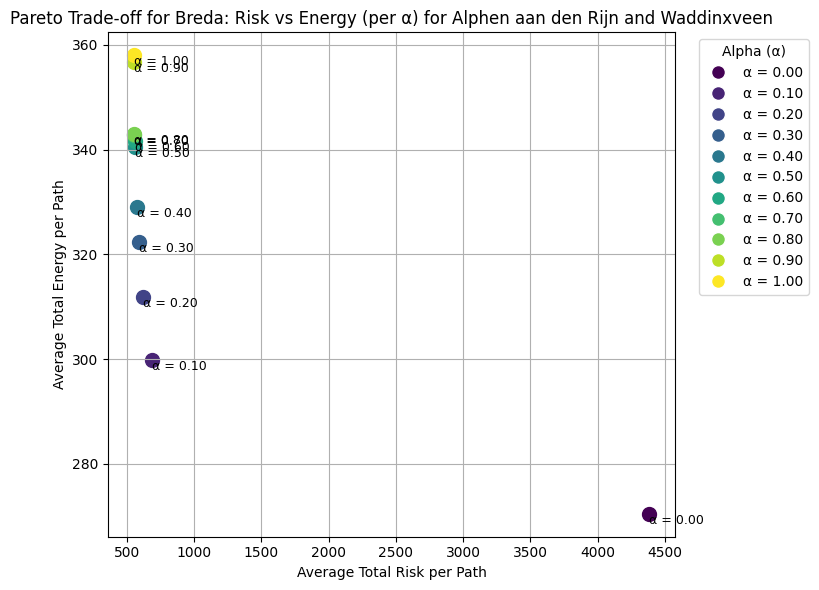

In [24]:
fig = plot_pareto_tradeoff1(df_summary)
fig.savefig(f"output/{city}_pareto.pdf", dpi=300, bbox_inches="tight")

In [25]:
import folium
import pyproj
from shapely.geometry import Point, LineString, Polygon
from shapely.ops import transform
from shapely.wkt import loads as wkt_loads
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from matplotlib.lines import Line2D
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from matplotlib.patches import Patch
from collections import Counter
import pandas as pd
import seaborn as sns

def plot_common_etypes_per_alpha(etype_dict_per_alpha, city="Unknown", title_prefix="Most Common Etypes in"):
    """
    Creates one bar plot per alpha, showing the frequency of etypes.
    Ensures the same y-axis scale across all plots for comparison.

    Args:
        etype_dict_per_alpha (dict): Dictionary where keys are alpha values and values are lists of etypes.
        title_prefix (str): Title prefix to display before the alpha value.
    """

    area_color_map = {
        # Infrastructuur
        'Motorways and major roads': '#E31A1C',       # felrood
        'Regional roads': '#F46D43',                  # vurig oranje
        'Tracks and rural access roads': '#D95F02',   # donkeroranje
        'Living and residential streets': '#FFCB05',  # felgeel
        'Pedestrian and cycling paths': '#66C2A5',    # turquoisegroen
        'Railways': '#4B4B4B',                        # donkergrijs
        'Helipads': '#F0027F',
        'Airports and airfields': '#A6CEE3',

        # Energie & communicatie
        'Power lines': '#999999',
        'Power plants': '#FF8C00',
        'Communication towers': '#FB9A99',
        'High infrastructures': '#888888',

        # Gebouwd gebied
        'Industrial zones': '#377EB8',               # helderblauw
        'Commercial zones': '#FFC300',               # goudgeel
        'Retail zones': '#FF8C00',                   # warm oranje
        'Residential areas': '#FFA07A',              # warm zalm/oranjerood – beter onderscheid met 'Retail zones'
        'Schools and universities': '#DAA520',
        'Hospitals': '#DC143C',
        'Care homes': '#FF9999',
        'Prisons': '#696969',
        'Religious sites': '#C71585',
        'Cemeteries': '#556B2F',
        'Cultural sites': '#8A2BE2',

        # Natuur
        'Parks': '#7CFC00',                          # limegroen
        'Recreational zones': '#20B2AA',
        'Meadows and open grass': '#9ACD32',         # geelgroen
        'Forests and woodlands': '#228B22',          # bosgroen
        'Agricultural lands': '#BFD92E',             # helderder dan '#ADDE87'
        'Wetlands': '#66B2FF',                       # licht, helder blauw
        'Lakes and ponds': '#1E90FF',                # diepblauw (meer contrast met 'Wetlands')
        'Water reservoirs': '#4682B4',
        'Rivers, canals and streams': '#5DADE2',
        'Natura2000 areas': '#005824',

        # Overig
        'connector': '#D3D3D3',
        'No-fly zone': '#B22222'
    }
    all_etypes = sorted(set(et for etypes in etype_dict_per_alpha.values() for et in etypes))
    global_max = max((Counter(ets).most_common(1)[0][1] if ets else 0) for ets in etype_dict_per_alpha.values())

    for alpha, etypes in etype_dict_per_alpha.items():
        counts = Counter(etypes)
        etype_df = pd.DataFrame({
            "etype": all_etypes,
            "count": [counts.get(e, 0) for e in all_etypes]
        })

        plt.figure(figsize=(12, 5))
        colors = [area_color_map.get(e, "#cccccc") for e in etype_df["etype"]]
        sns.barplot(data=etype_df, x="etype", y="count", palette=colors)
        plt.ylim(0, global_max * 1.1)
        plt.xticks(rotation=45, ha='right')
        plt.xlabel("Edge type (etype)")
        plt.ylabel("Total count")
        plt.title(f"{title_prefix} {city} (α = {alpha:.2f})")
        plt.tight_layout()
        plt.show()


/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


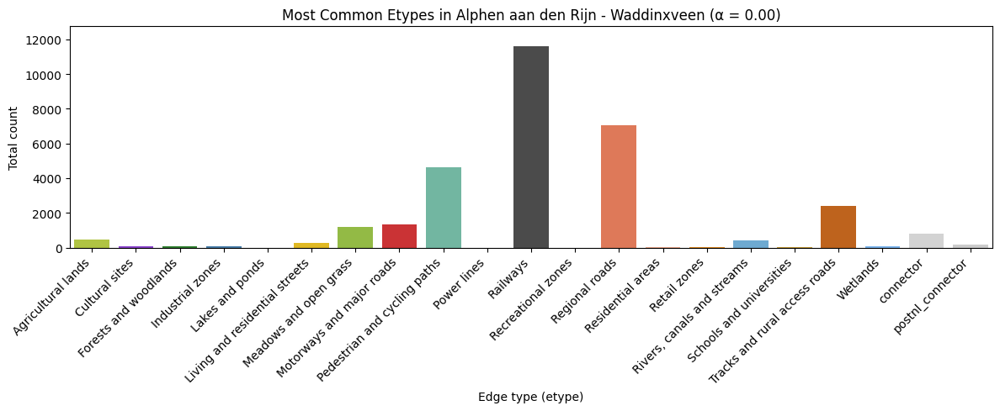

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


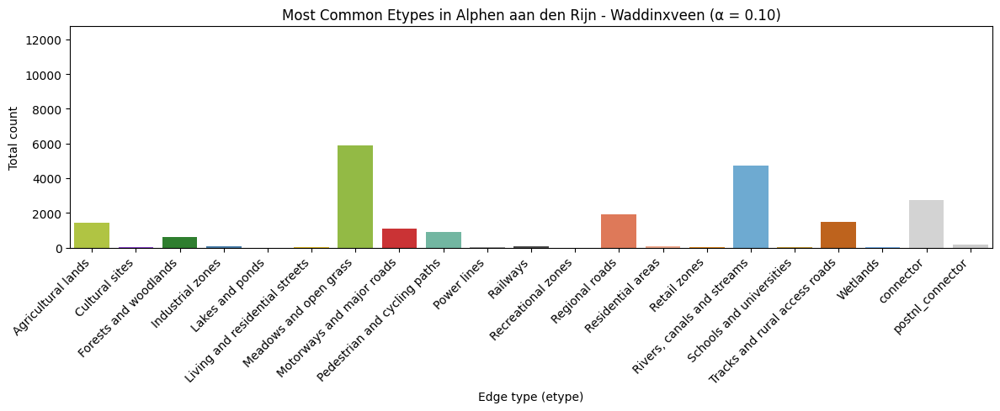

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


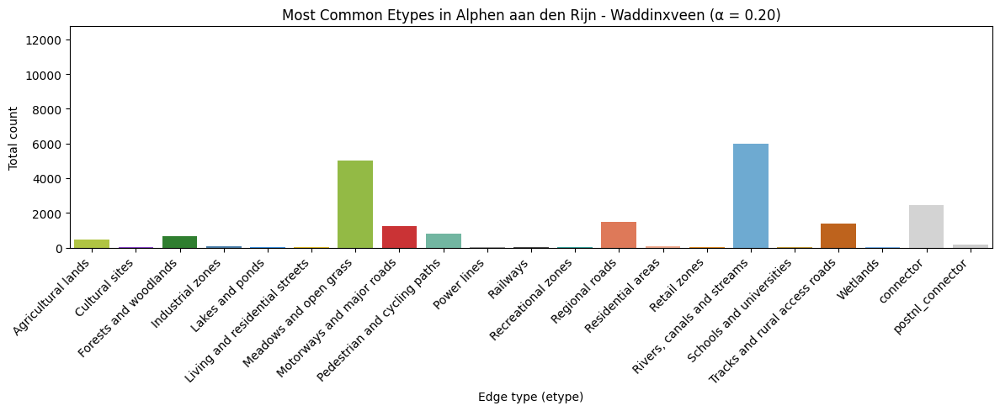

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


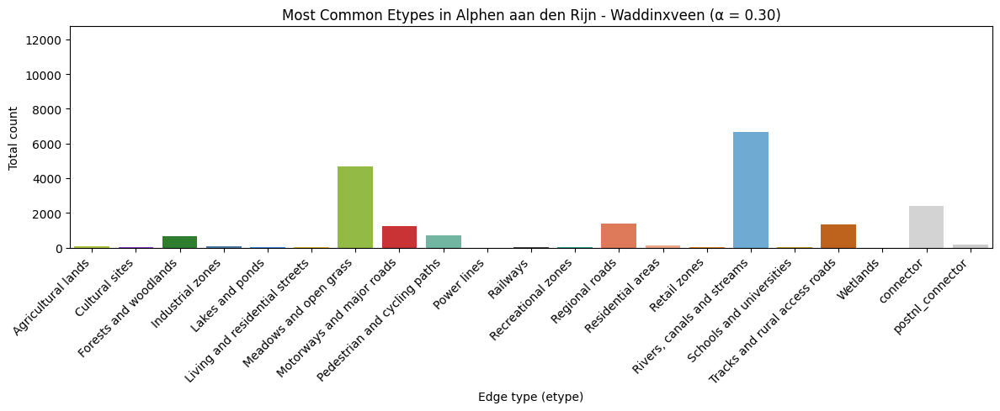

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


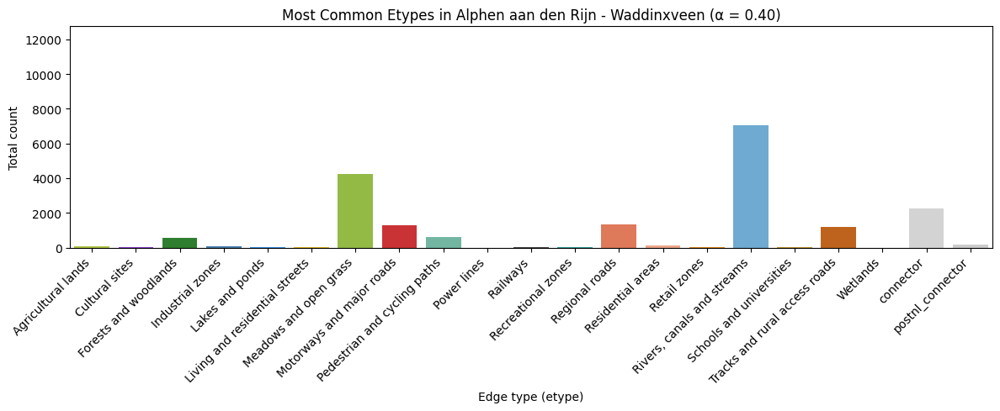

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


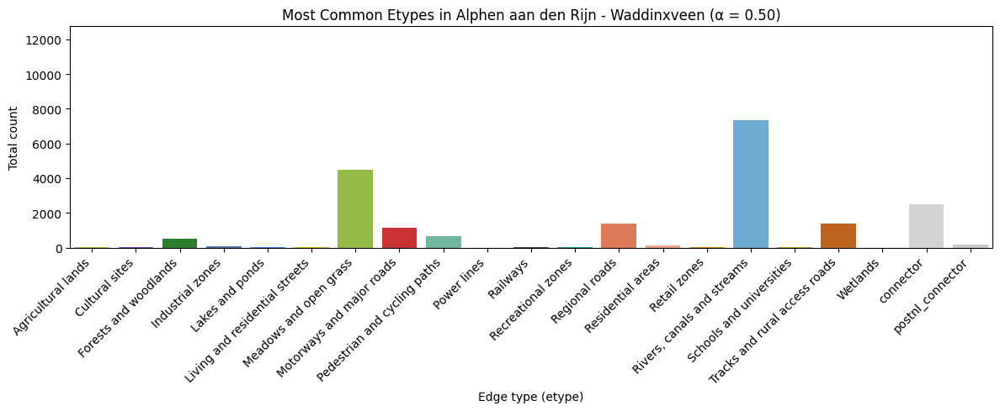

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


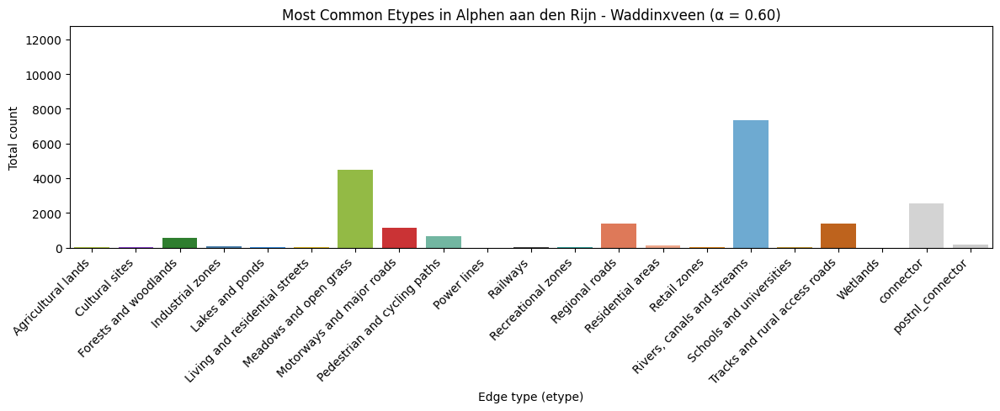

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


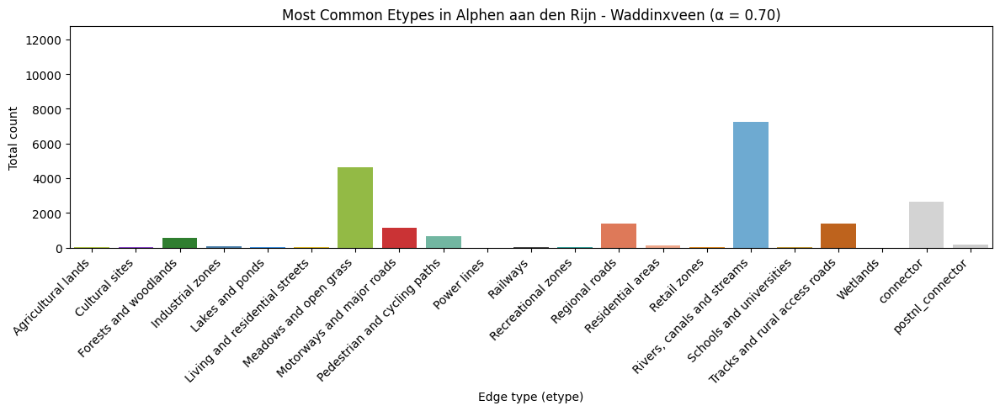

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


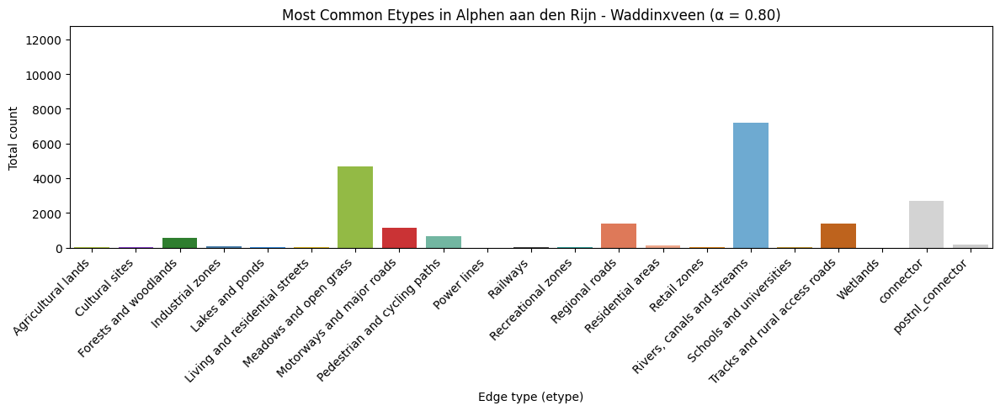

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


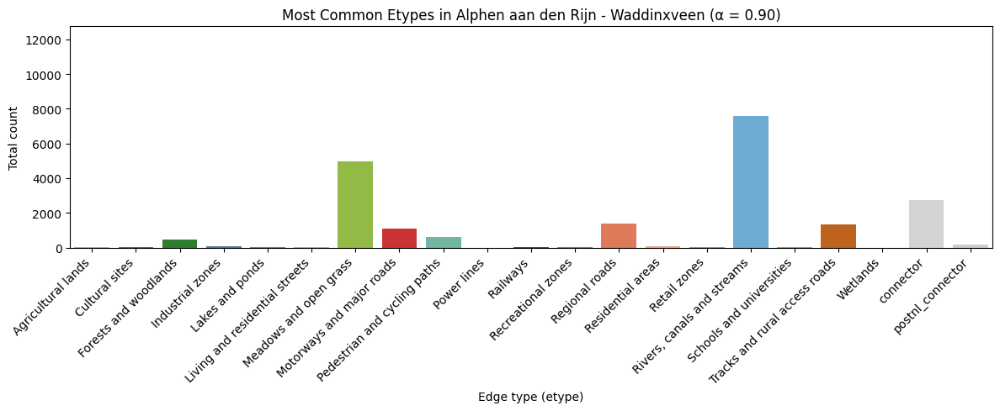

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_74746/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


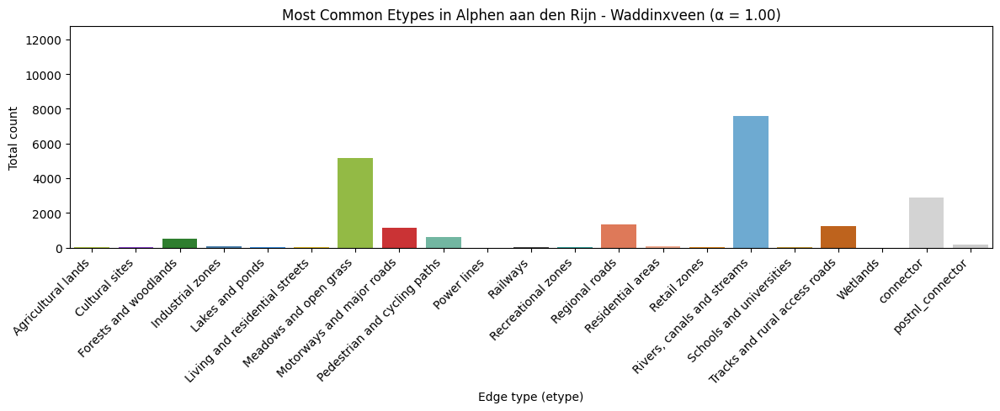

In [26]:
plot_common_etypes_per_alpha(etype_dict_per_alpha, city='Alphen aan den Rijn - Waddinxveen')

In [28]:
cols = ["alpha", "mean_risk", "mean_energy", "mean_length", "max_length", "min_length", "avg_steps", "n_unique_etypes"]
df_latex = df_summary[cols]
# Exporteer als LaTeX-tabel (alleen als korte variant gewenst)
with open("output/alphen_waddinxveen_sum.tex", "w") as f:
    f.write(df_latex.to_latex(index=False, float_format="%.3f", caption="Summary of UAV corridor paths in Alphen aan den Rijn and Waddinxveen", label="tab:alphen_waddinxveen_summary", column_format="lcccccc"))